In [1]:
import numpy as np
import pandas as pd
from scipy import signal
import matplotlib.pyplot as plt
import viewer.load_data as load_data
import viewer.segment_data as segmentation
import viewer.filters as filt
from viewer.denoising_data import denoise_signals
import viewer.visualization as viz
import viewer.preprocessing as preprocess
from constants import DatasetInfo 
import warnings
warnings.filterwarnings('ignore')

### Introduction
- This notebook contains tests of viewer functions using synthetic signals. 
- The functions tested are:
    1. plot_signal(): plots input signal in time and amplitude.
    2. plot_spectrogram(): plots the spectrogram of input signal.
    3. plot_sscwt_cwt(): plots cwt, sscwt, or both cwt and sscwt of signal.
    4. plot_psd(): plots power spectral density of input signal.
    5. create_filter(): creates an IIR or FIR filter based on user input.
    6. plot_filter_prop(): plots filter magnitude, phase, impulse, and step responses.
    7. describe_signal(): constructs a dataframe containing the input signal descriptive statistics, skewness, kurtosis, DF, and DP.
    8. resample_signal(): resamples the input signal based on the target number of samples, upsampling ratio, or downsampling ratio.



#### build synthetic signal

In [2]:
fs = 5000  # Hz
time = 15  # seconds
first_sig_freq = 22  # Hz
second_sig_freq = 60 # Hz
first_signal_amplitude = 2  # V
second_signal_amplitude = 1  # V

n_samples = time * fs
t = np.linspace(0, time, n_samples)
noise_pct = 0.1  
noise = (first_signal_amplitude * noise_pct) * np.random.normal(0, 0.5, n_samples)
sig = first_signal_amplitude * np.sin(
    2 * np.pi * first_sig_freq * t) + second_signal_amplitude * np.sin(
        2 * np.pi * second_sig_freq * t ) 
noisy_sig = sig + noise
sig = sig.reshape(sig.shape[0],1)
noisy_sig = noisy_sig.reshape(noisy_sig.shape[0],1)

In [3]:
sig.shape

(75000, 1)

#### Plot signal

##### Viewer plotting

In [4]:
viz.plot_signal(sig,t=10,n_chs=1,fs=500)

##### Matplotlib plotting

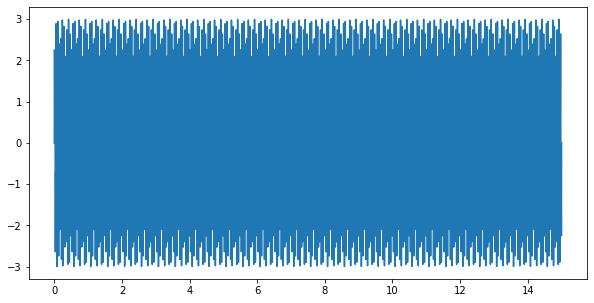

In [5]:
plt.figure(figsize=(10,5))
plt.plot(t,sig)

##### Viewer plotting

In [6]:
viz.plot_signal(noisy_sig,t=10,n_chs=1,fs=500)

##### Matplotlib plotting

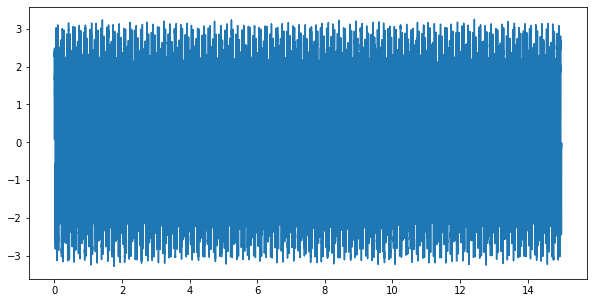

In [7]:
plt.figure(figsize=(10,5))
plt.plot(t,noisy_sig)

#### Plot PSD

In [8]:
viz.plot_psd(sig,n_chs=1,fs=5000)

1.4834917225693072e-34


In [9]:
viz.plot_psd(noisy_sig,n_chs=1,fs=500)

1.0396862131455123e-09


#### Describe signal

In [10]:
sig_des = preprocess.describe_signal(sig,n_ch=1,fs=500)

In [11]:
sig_des

,name,unit,length,min,max,mean,Q1,median,Q3,mode,variance,skew,kurtosis,DF,DP
0,1,float64,75000,-2.99784,2.99784,6.139089e-17,-1.239733,-4.468403e-13,1.239733,-2.99784,2.499967,4.793554e-17,-1.019974,0.0088,49998.751387


#### Resample signal

###### Resampling using number of samples

In [12]:
res_sig = preprocess.resample_signal(sig,number_of_samples=4000)
res_sig.shape

(4000, 1)

In [13]:
viz.plot_signal(res_sig,t=10,n_chs=1,fs=500)

##### Resampling using downsampling ratio

In [14]:
res_sig2 = preprocess.resample_signal(sig,downsample=2)
res_sig2.shape

37500


(37500, 1)

In [15]:
viz.plot_signal(res_sig2,t=10,n_chs=1,fs=500)

#### Plot Spectrogram

##### Viewer plotting

In [16]:
viz.plot_spectrogram(sig,n_chs=1,fs=500)

##### Matplotlib Plotting

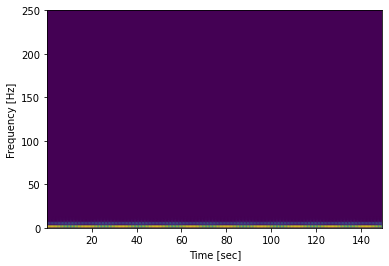

In [17]:
f, t, Sxx = signal.spectrogram(sig.flatten(), fs=500)
plt.pcolormesh(t, f, Sxx, shading='gouraud')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

##### Viewer plotting

In [ ]:
viz.plot_spectrogram(noisy_sig,n_chs=1,fs=500)

##### Matplotlib Plotting

In [ ]:
f, t, Sxx = signal.spectrogram(noisy_sig.flatten(), fs=500)
plt.pcolormesh(t, f, Sxx, shading='gouraud')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

#### Plot SSWCT and CWT

In [ ]:
viz.plot_sscwt_cwt(sig,n_chs=1,fs=500,type='sscwt/cwt')

In [ ]:
viz.plot_sscwt_cwt(noisy_sig,n_chs=1,fs=500,type='sscwt/cwt')

#### Create Filter

In [ ]:
filt1, w,h = filt.create_filter(order=17,fs=700,f_low=50,f_high=200, rs=60,
                        btype='band', analog=False, ftype='cheby2')

In [ ]:
filt2, w2,h2 = filt.create_filter(order=1000,fs=2,f_low=0.2,f_high=0.5,method='fir', window = 'blackmanharris',
                        btype=False)



#### Plot Filter Properties

In [ ]:
b,a = filt1
viz.plot_filter_prop(b,a,w,h,fs=700)

In [ ]:
b2 = filt2
viz.plot_filter_prop(b2,1,w2,h2,fs=2)